## Analyzing a pretrained VGG model

In [ ]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import numpy as np

print('Tensorflow Version:', tf.__version__)
print('keras version:', keras.__version__)

Tensorflow Version: 2.4.1
keras version: 2.4.0


In [ ]:
from keras.applications import VGG16

vgg = VGG16(weights='imagenet', include_top=True)
vgg.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

### Visualizing Filters

Layer Names
  0 input_1   
  1 block1_conv1
  2 block1_conv2
  3 block1_pool
  4 block2_conv1
  5 block2_conv2
  6 block2_pool
  7 block3_conv1
  8 block3_conv2
  9 block3_conv3
 10 block3_pool
 11 block4_conv1
 12 block4_conv2
 13 block4_conv3
 14 block4_pool
 15 block5_conv1
 16 block5_conv2
 17 block5_conv3
 18 block5_pool
 19 flatten   
 20 fc1       
 21 fc2       
 22 predictions
{'name': 'block5_conv1', 'trainable': True, 'dtype': 'float32', 'filters': 512, 'kernel_size': (3, 3), 'strides': (1, 1), 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': (1, 1), 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}
Number of layers =  23
(3, 3, 3, 64)
(3, 3, 64, 128)
(3, 3, 128, 256)
(3, 3, 256, 51

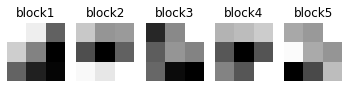

In [ ]:
print('Layer Names')
layers_info = {}
count = 0
for i in vgg.layers:
  layers_info[i.name] = i.get_config()
  print("{:3.0f} {:10}".format(count, i.name))
  count += 1

layer_weights = {}
for i in vgg.layers:
  layer_weights[i.name] = i.get_weights()

print(layers_info['block5_conv1'])
print('Number of layers = ', len(vgg.layers))

layers = vgg.layers
layer_ids = [1, 4, 7, 11, 15]


# plot the filters
fig, axs = plt.subplots(nrows=1, ncols=5)
for i in range(5):
  print(np.shape(layers[layer_ids[i]].get_weights()[0]))
  axs[i].imshow(layers[layer_ids[i]].get_weights()[0][:,:,:,0][:,:,0], cmap='gray')
  axs[i].set_title('block'+str(i+1))
  axs[i].axis("off")

### Download an image from web

In [ ]:
from google.colab import files as FILE
import os
import requests

DownURL = 'https://cdn.analyticsvidhya.com/wp-content/uploads/2019/04/indian_elephant.jpg'


img_data = requests.get(DownURL).content
with open('indian_elephant.jpg', 'wb') as handler:
  handler.write(img_data)

#FILE.download('image_name.jpg')

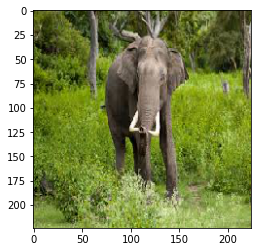

Shape of Image: (224, 224, 3)
Shape of Image tensor: tf.Tensor([  1 224 224   3], shape=(4,), dtype=int32)


In [ ]:
from keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
import numpy as np

img = load_img("indian_elephant.jpg", target_size=(224,224))
plt.imshow(img)
plt.show()

img_array = img_to_array(img) / 255
img_tensor = tf.convert_to_tensor(np.expand_dims(img_array, axis=0))
print('Shape of Image:', np.shape(img_array))
print('Shape of Image tensor:', tf.shape(img_tensor))

### Visualizing Conv Layer Outputs

In [ ]:
from keras import models

# extract the outputs from all the layers
layer_outputs = [layer.output for layer in vgg.layers[1:]]

# create a model that will return these outputs given the model input
activation_model = models.Model(inputs=vgg.input, outputs=layer_outputs)

activations = activation_model.predict(img_tensor)
print('Number of Layer outputs to examine:', len(activations))

print('Layer output shapes:')
for i in range(len(activations)):
  print(activations[i].shape)

Number of Layer outputs to examine: 22
Layer output shapes:
(1, 224, 224, 64)
(1, 224, 224, 64)
(1, 112, 112, 64)
(1, 112, 112, 128)
(1, 112, 112, 128)
(1, 56, 56, 128)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 28, 28, 256)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 14, 14, 512)
(1, 14, 14, 512)
(1, 14, 14, 512)
(1, 14, 14, 512)
(1, 7, 7, 512)
(1, 25088)
(1, 4096)
(1, 4096)
(1, 1000)


First Layer Activation shape: (1, 224, 224, 64)


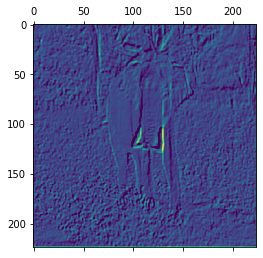

In [ ]:
first_layer_activation = activations[0]
print('First Layer Activation shape:', first_layer_activation.shape)

plt.matshow(first_layer_activation[0,:,:,0], cmap='viridis')

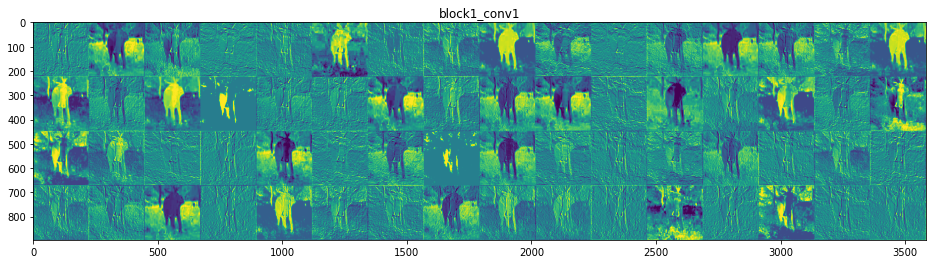

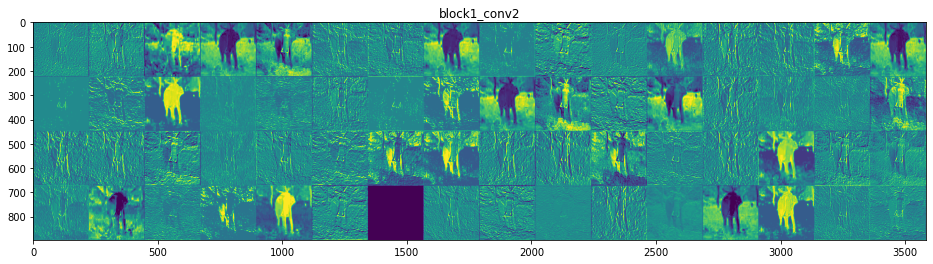

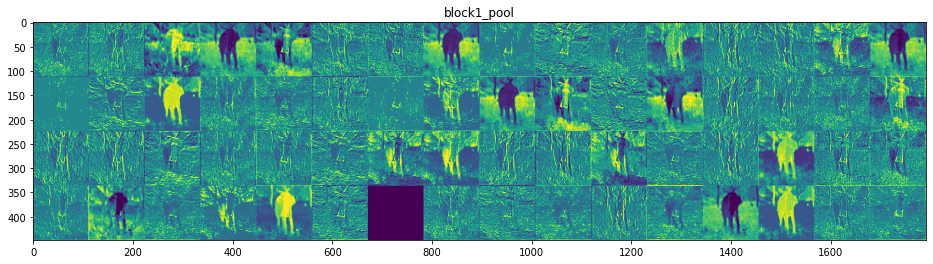

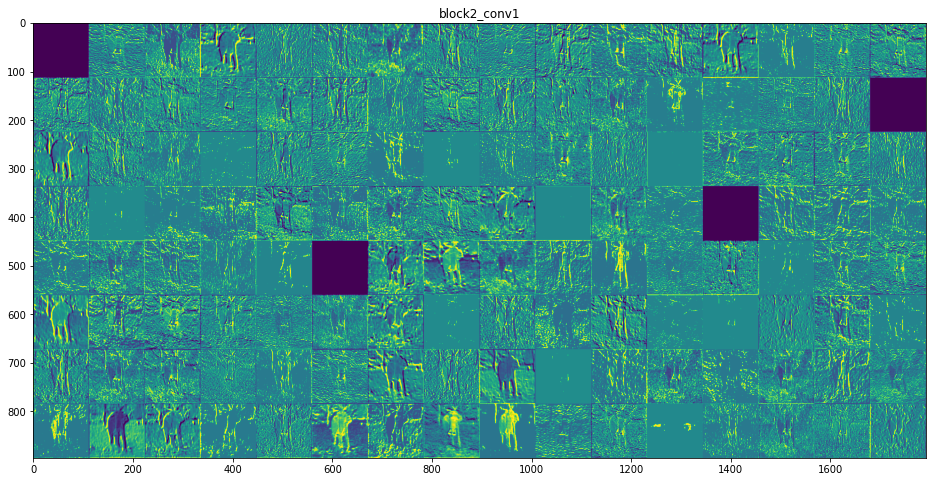

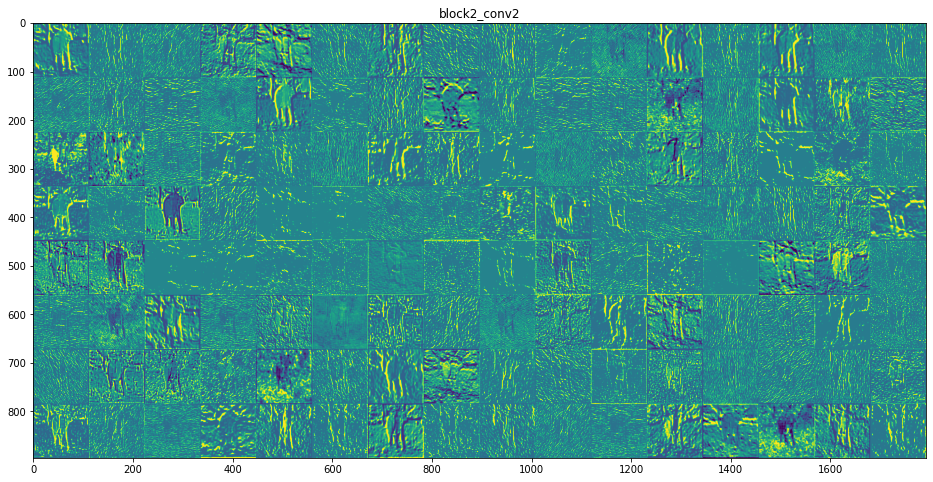

...

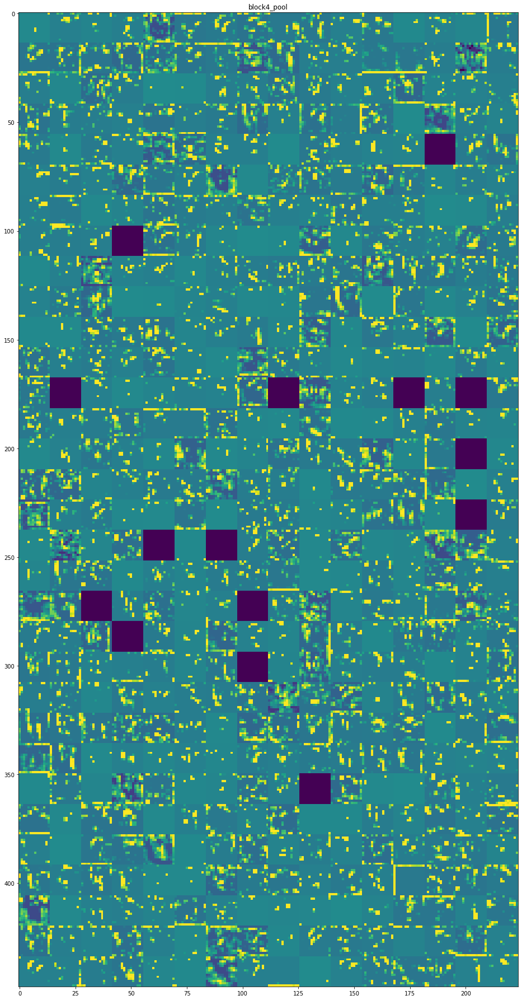

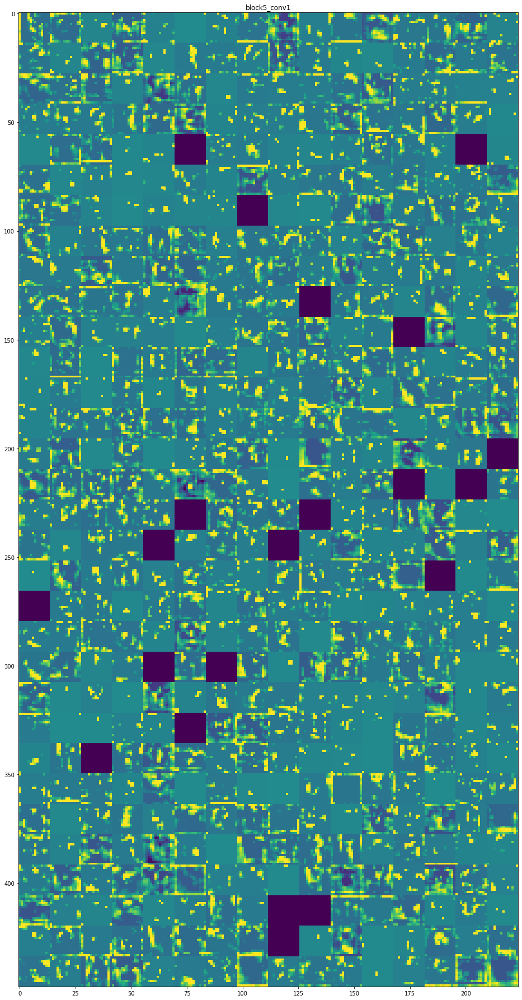

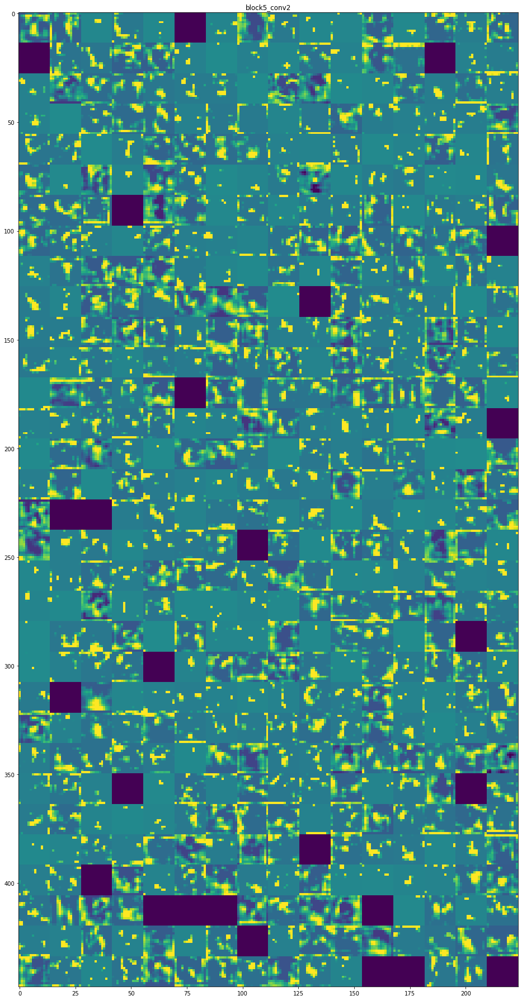

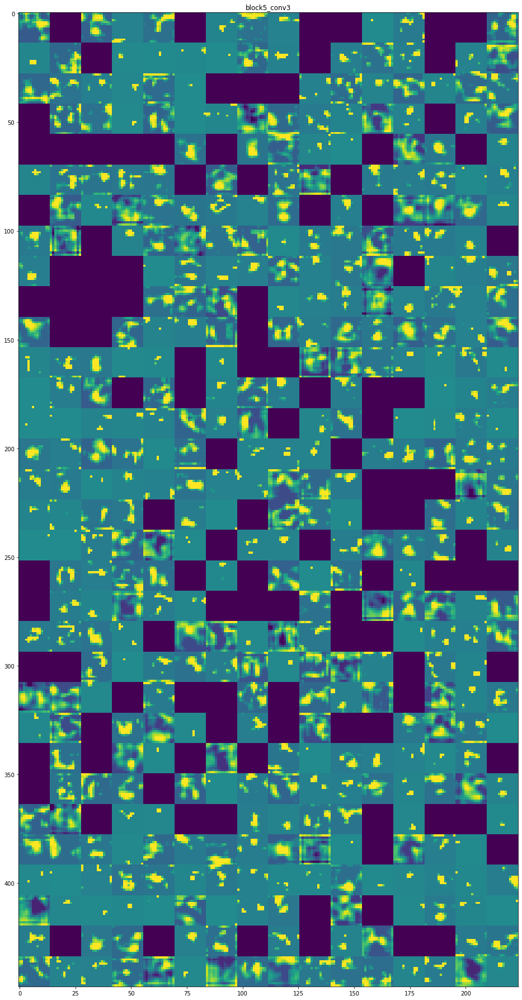

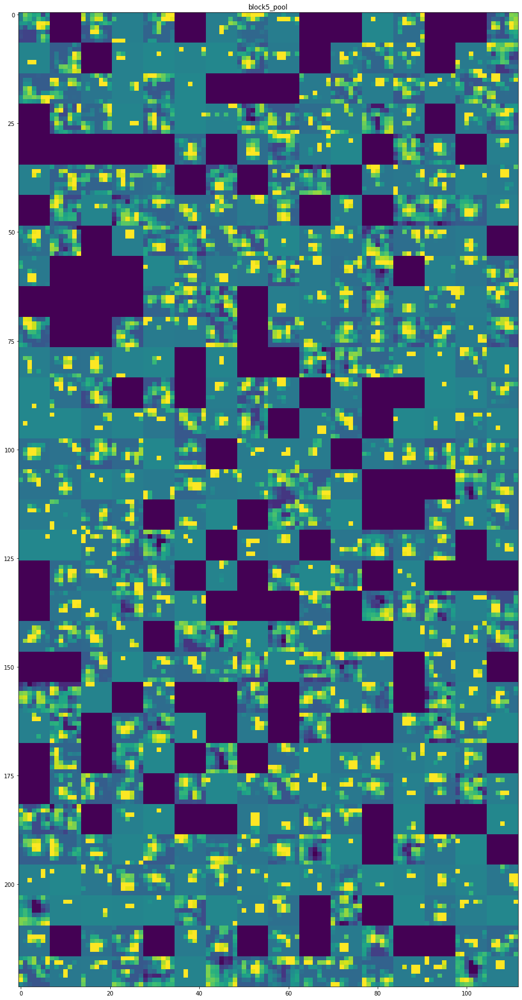

In [ ]:
layer_names = []
for layer in vgg16.layers[1:]:
  layer_names.append(layer.name)

images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
  #print('Shape of Layer Activation:', layer_activation.shape)
  n_features = layer_activation.shape[-1] # number of filter channels
  size = layer_activation.shape[1]
  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))

  for col in range(n_cols):
    for row in range(images_per_row):
      channel_image = layer_activation[0, :, :, 
                                       col * images_per_row + row]
      # post process
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 64
      channel_image += 128
      channel_image = np.clip(channel_image, 0, 255).astype('uint8')
      display_grid[col * size : (col+1) * size,
                   row * size : (row+1) * size] = channel_image

  #print('shape of display grid', np.shape(display_grid))   
  # Display the grid
  scale = 1. / size
  plt.figure(figsize=(scale * display_grid.shape[1],
                      scale * display_grid.shape[0]))
  plt.title(layer_name)
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
plt.show()

### Visualizing ConvNet Filters by analyzing gradients

In [ ]:
# download a json file containing imagenet class labels

!wget "https://raw.githubusercontent.com/raghakot/keras-vis/master/resources/imagenet_class_index.json"

--2021-03-18 17:26:51--  https://raw.githubusercontent.com/raghakot/keras-vis/master/resources/imagenet_class_index.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35363 (35K) [text/plain]
Saving to: ‘imagenet_class_index.json’

imagenet_class_inde 100%[===================>]  34.53K  --.-KB/s    in 0.001s  

2021-03-18 17:26:51 (26.8 MB/s) - ‘imagenet_class_index.json’ saved [35363/35363]



In [ ]:
import json
CLASS_INDEX = json.load(open("imagenet_class_index.json"))
classlabel  = []
for i_dict in range(len(CLASS_INDEX)):
    classlabel.append(CLASS_INDEX[str(i_dict)][1])
print("N of class={}".format(len(classlabel)))

N of class=1000


In [ ]:
from keras.applications.vgg16 import preprocess_input, decode_predictions

print('Input shape', tf.shape(img_tensor))
preds = vgg.predict(img_tensor)
print('Output Shape:', tf.shape(preds))
print(decode_predictions(preds, top=3)[0])

idx = np.argmax(preds[0])
print('Class label: {} with probability: {}'.format(classlabel[idx], preds[0][idx]))


NameError: ignored

In [ ]:
from keras.applications.vgg16 import preprocess_input
img = preprocess_input(img_array)
y_pred = vgg.predict(img[np.newaxis,...])
#y_pred = vgg.predict(img_tensor)
class_idxs_sorted = np.argsort(y_pred.flatten())[::-1]
topNclass = 5
for i, idx in enumerate(class_idxs_sorted[:topNclass]):
    print("Top {} predicted class:     Pr(Class={:18} [index={}])={:5.3f}".format(
          i + 1,classlabel[idx],idx,y_pred[0,idx]))

Top 1 predicted class:     Pr(Class=matchstick         [index=644])=0.260
Top 2 predicted class:     Pr(Class=nematode           [index=111])=0.141
Top 3 predicted class:     Pr(Class=digital_clock      [index=530])=0.065
Top 4 predicted class:     Pr(Class=lighter            [index=626])=0.062
Top 5 predicted class:     Pr(Class=spotlight          [index=818])=0.043


## Gradient Class Activation Maps (gradCAM)

https://keras.io/examples/vision/grad_cam/

In [ ]:
import tensorflow.keras.backend as K
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions
from tensorflow.keras.preprocessing import image
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
model2 = InceptionV3(weights='imagenet')
model2.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d_376 (Conv2D)             (None, 149, 149, 32) 864         input_14[0][0]                   
__________________________________________________________________________________________________
batch_normalization_376 (BatchN (None, 149, 149, 32) 96          conv2d_376[0][0]                 
__________________________________________________________________________________________________
activation_376 (Activation)     (None, 149, 149, 32) 0           batch_normalization_376[0][0]    
_______________________________________________________________________________________

In [ ]:
!wget https://indiasendangered.com/wp-content/uploads/2011/09/elephant.jpg
!wget https://s3.amazonaws.com/cdn-origin-etr.akc.org/wp-content/uploads/2017/11/12234558/Chinook-On-White-03.jpg
!wget https://icatcare.org/app/uploads/2018/07/Thinking-of-getting-a-cat.png

--2021-03-18 17:01:46--  https://indiasendangered.com/wp-content/uploads/2011/09/elephant.jpg
Resolving indiasendangered.com (indiasendangered.com)... 199.79.62.149
Connecting to indiasendangered.com (indiasendangered.com)|199.79.62.149|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 137242 (134K) [image/jpeg]
Saving to: ‘elephant.jpg’

elephant.jpg        100%[===================>] 134.03K  --.-KB/s    in 0.1s    

2021-03-18 17:01:47 (1.07 MB/s) - ‘elephant.jpg’ saved [137242/137242]

--2021-03-18 17:01:47--  https://s3.amazonaws.com/cdn-origin-etr.akc.org/wp-content/uploads/2017/11/12234558/Chinook-On-White-03.jpg
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.244.206
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.244.206|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25761 (25K) [image/jpeg]
Saving to: ‘Chinook-On-White-03.jpg’

Chinook-On-White-03 100%[===================>]  25.16K  --.-KB/s    in 0.06s   

20

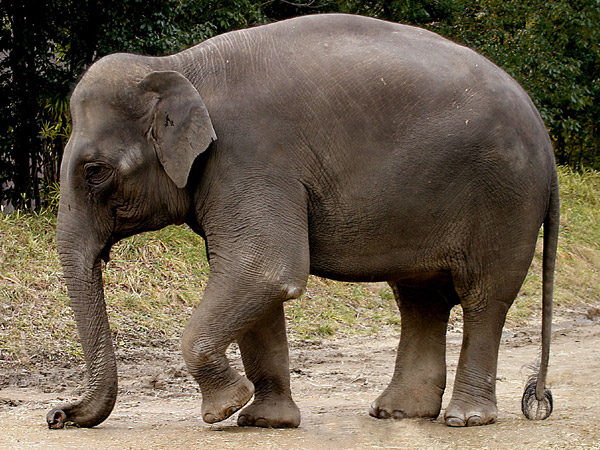

In [ ]:
ORIGINAL = 'elephant.jpg'
DIM = 299

img = image.load_img(ORIGINAL, target_size=(DIM, DIM))
cv2_imshow(cv2.imread(ORIGINAL))

In [ ]:
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)
print('Input Shape', tf.shape(x))
preds = model2.predict(x)
print(decode_predictions(preds))

Input Shape tf.Tensor([  1 299 299   3], shape=(4,), dtype=int32)
[[('n02504013', 'Indian_elephant', 0.9624098), ('n01871265', 'tusker', 0.015191134), ('n02504458', 'African_elephant', 0.00047370428), ('n04346328', 'stupa', 0.0003335498), ('n01694178', 'African_chameleon', 0.00029568523)]]


In [ ]:
for layer in model2.layers:
  print(layer.name)

input_14
conv2d_376
batch_normalization_376
activation_376
conv2d_377
batch_normalization_377
activation_377
conv2d_378
batch_normalization_378
activation_378
max_pooling2d_16
conv2d_379
batch_normalization_379
activation_379
conv2d_380
batch_normalization_380
activation_380
max_pooling2d_17
conv2d_384
batch_normalization_384
activation_384
conv2d_382
conv2d_385
batch_normalization_382
batch_normalization_385
activation_382
activation_385
average_pooling2d_36
conv2d_381
conv2d_383
conv2d_386
conv2d_387
batch_normalization_381
batch_normalization_383
batch_normalization_386
batch_normalization_387
activation_381
activation_383
activation_386
activation_387
mixed0
conv2d_391
batch_normalization_391
activation_391
conv2d_389
conv2d_392
batch_normalization_389
batch_normalization_392
activation_389
activation_392
average_pooling2d_37
conv2d_388
conv2d_390
conv2d_393
conv2d_394
batch_normalization_388
batch_normalization_390
batch_normalization_393
batch_normalization_394
activation_388
act

tf.Tensor([  1   8   8 192], shape=(4,), dtype=int32)


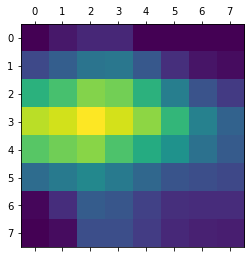

In [ ]:
with tf.GradientTape() as tape:
  last_conv_layer = model.get_layer('conv2d_281')
  iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
  model_out, last_conv_layer = iterate(x)
  class_out = model_out[:, np.argmax(model_out[0])]
  grads = tape.gradient(class_out, last_conv_layer)
  print(tf.shape(grads))
  pooled_grads = K.mean(grads, axis=(0, 1, 2))

heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)

heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
heatmap = heatmap.reshape((8, 8))
plt.matshow(heatmap)
plt.show()

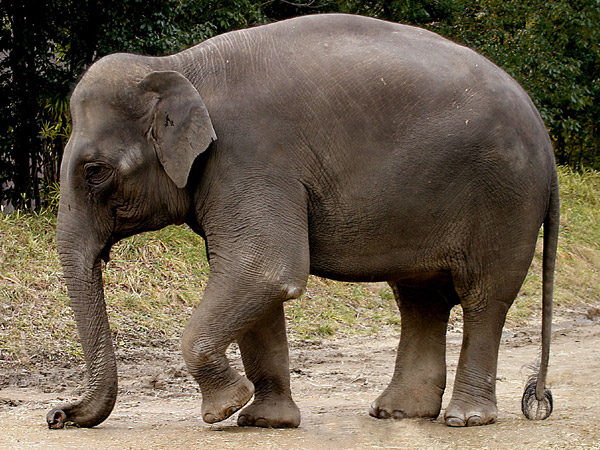

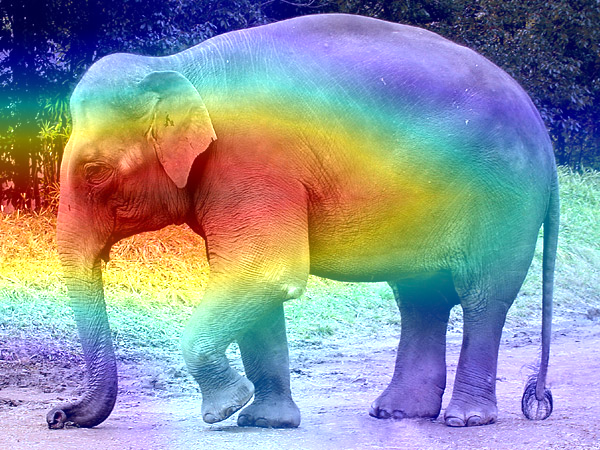

In [ ]:
img = cv2.imread(ORIGINAL)
INTENSITY = 0.5
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
img = heatmap * INTENSITY + img

cv2_imshow(cv2.imread(ORIGINAL))
cv2_imshow(img)

In [ ]:
def gradCAM(orig, intensity=0.5, res=250):
  img = image.load_img(orig, target_size=(DIM, DIM))

  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  preds = model.predict(x)
  print(decode_predictions(preds)[0][0][1])

  with tf.GradientTape() as tape:
    last_conv_layer = model.get_layer('conv2d_281')
    iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
    model_out, last_conv_layer = iterate(x)
    class_out = model_out[:, np.argmax(model_out[0])]
    grads = tape.gradient(class_out, last_conv_layer)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

  heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)

  heatmap = np.maximum(heatmap, 0)
  heatmap /= np.max(heatmap)
  heatmap = heatmap.reshape((8, 8))

  img = cv2.imread(orig)
  heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
  heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
  img = heatmap * intensity + img

  cv2_imshow(cv2.resize(cv2.imread(orig), (res, res)))
  cv2_imshow(cv2.resize(img, (res, res)))

Labrador_retriever


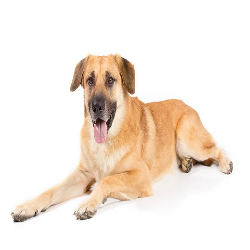

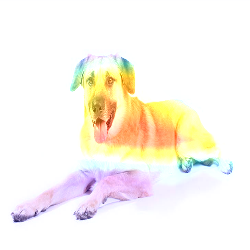

tabby


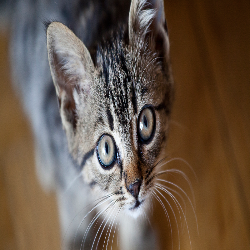

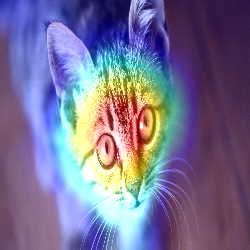

In [ ]:
gradCAM("Chinook-On-White-03.jpg")
gradCAM("Thinking-of-getting-a-cat.png")

mosquito_net
Shape of heatmap tf.Tensor([ 1 14 14], shape=(3,), dtype=int32)


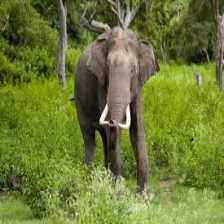

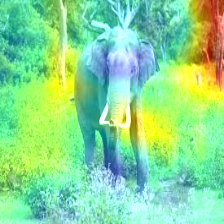

In [ ]:
def gradCAM(model, layer_name, orig, DIM, intensity=0.5, res=250):
  img = image.load_img(orig, target_size=(DIM, DIM))

  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  preds = model.predict(x)
  print(decode_predictions(preds)[0][0][1])

  with tf.GradientTape() as tape:
    last_conv_layer = model.get_layer(layer_name)
    iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
    model_out, last_conv_layer = iterate(x)
    class_out = model_out[:, np.argmax(model_out[0])]
    grads = tape.gradient(class_out, last_conv_layer)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

  heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)

  heatmap = np.maximum(heatmap, 0)
  heatmap /= np.max(heatmap)
  hm_shape = heatmap.shape
  print('Shape of heatmap', tf.shape(heatmap))
  heatmap = heatmap.reshape((hm_shape[1], hm_shape[1]))

  img = cv2.imread(orig)
  heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
  heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
  img = heatmap * intensity + img

  cv2_imshow(cv2.resize(cv2.imread(orig), (res, res)))
  cv2_imshow(cv2.resize(img, (res, res)))


#gradCAM(model2, 'conv2d_469', "Chinook-On-White-03.jpg", DIM=299, res=250)
gradCAM(vgg, 'block5_conv3', 'indian_elephant.jpg', DIM=224, res=224)

## TF Keras Visualization 

In [ ]:
import tensorflow as tf
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras import activations
import numpy as np

# Model configuration
img_width, img_height = 32, 32
batch_size = 250
no_epochs = 1
no_classes = 10
validation_split = 0.2
verbosity = 1

# load dataset
(input_train, target_train), (input_test, target_test) = cifar10.load_data()

# reshape dataset
input_train = input_train.reshape(input_train.shape[0], img_width, img_height, 3)
input_test = input_test.reshape(input_test.shape[0], img_width, img_height, 3)
input_shape = (img_width, img_height, 3)

input_train = input_train.astype('float32')
input_test = input_test.astype('float32')

print('shape of input_train', np.shape(input_train))

target_train = tf.keras.utils.to_categorical(target_train, no_classes)
target_test = tf.keras.utils.to_categorical(target_test, no_classes)

# create model
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(no_classes, activation='softmax', name='visualized_layer'))
model.summary()

# Compile the model
model.compile(loss=tf.keras.losses.categorical_crossentropy,
              optimizer=tf.keras.optimizers.Adam(),
              metrics=['accuracy'])

# train the model
model.fit(input_train, target_train, batch_size=250,
          epochs=1, verbose=1,
          validation_split=0.2)

# Evaluate the model
score = model.evaluate(input_test, target_test, verbose=0)
print(f'Test Loss: {score[0]} / Test Accuracy: {score[1]}')

shape of input_train (50000, 32, 32, 3)
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 30, 30, 32)        896       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 15, 15, 32)        0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 15, 15, 32)        0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 7200)              0         
_________________________________________________________________
dense_6 (Dense)              (None, 256)               1843456   
_________________________________________________________________
visualized_layer (Dense)     (None, 10)                2570      
Total params: 1,846,922
Trainable params: 1,846,922
Non-trainable params: 0
____

## Saliency Maps in Tensorflow 2.x

Saliency maps is a technique to rank the pixels in an image based on their contribution to the final score from a ConvNet.

Let's assume that a ConvNet gives a class score $S_c(I)$ for an input image $I$ belonging to class $c$. 

The term $S_c(I)$ is highly nonlinear but we can use first-order Taylor series expansion to approximate it as a linear function:

$$S_c(I) \approx w^TI + b$$

where $w = \frac{\partial S_c}{\partial I}$ provides the saliency map for a given image. The magnitude of w indicates which pixels need to be changed the least to affect the class score the most. 

In [ ]:
import tensorflow as tf
import tensorflow.keras as keras
import numpy as np
import matplotlib.pyplot as plt

print('tensorflow {}'.format(tf.__version__))
print('keras {}'.format(keras.__version__))

tensorflow 2.4.1
keras 2.4.0


In [ ]:
model = keras.applications.VGG16(weights='imagenet')
model.summary()

553467904/553467096 [==============================] - 5s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
____________________________________________________________

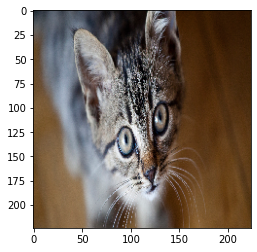

In [ ]:
_img = keras.preprocessing.image.load_img('Thinking-of-getting-a-cat.png', target_size=(224, 224))
plt.imshow(_img)
plt.show()

In [ ]:
img = keras.preprocessing.image.img_to_array(_img)
img = img.reshape((1, *img.shape))
y_pred = model.predict(img)

class_idxs_sorted = np.argsort(y_pred.flatten())[::-1]
topNclass = 5
for i, idx in enumerate(class_idxs_sorted[:topNclass]):
    print("Top {} predicted class:     Pr(Class={:18} [index={}])={:5.3f}".format(
          i + 1,classlabel[idx],idx,y_pred[0,idx]))

In [ ]:
images = tf.Variable(img, dtype=float)
with tf.GradientTape() as tape:
  pred = model(images, training=False)
  class_idxs_sorted = np.argsort(pred.numpy().flatten())[::-1]
  loss = pred[0][class_idxs_sorted[0]]

grads = tape.gradient(loss, images)


In [ ]:
dgrad_abs = tf.math.abs(grads)

# compute maximum of absolute gradient along the RGB channel
dgrad_max_ = np.max(dgrad_abs, axis=3)[0]

# normalize the grad between 0 and 1
arr_min, arr_max = np.min(dgrad_max_), np.max(dgrad_max_)
grad_eval = (dgrad_max_ - arr_min) / (arr_max - arr_min + 1e-18)

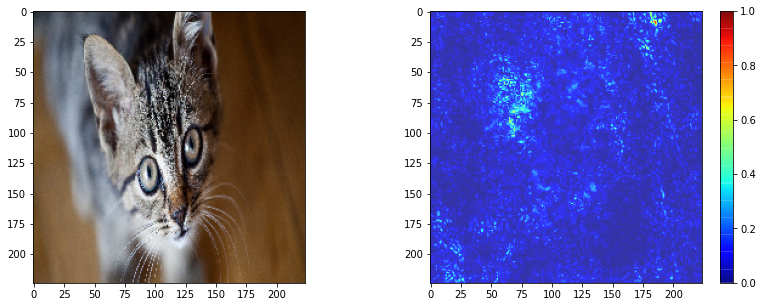

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14,5))
axes[0].imshow(_img)
i = axes[1].imshow(grad_eval, cmap='jet', alpha=0.8)
fig.colorbar(i)